# Análsis de datos con Melbourne

https://www.kaggle.com/datasets/anthonypino/melbourne-housing-market


## Carga de datos


In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from ydata_profiling import ProfileReport
from geopy.geocoders import Nominatim
from data_util import calc_missing


## Profiling


In [2]:
df = pd.read_csv(
    'C:\\Users\\Jholman Cuartas\\Desktop\\curso_analisis_datos\\data\\Melbourne_housing_FULL.csv')
df
# df = pd.read_csv(
# 'C:\\Users\\Jholman Cuartas\\Desktop\\curso_analisis_datos\\data\\Melbourne_housing_FULL.csv')
# df.head()


,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,...,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,Abbotsford,68 Studley St,2,h,NaN,SS,Jellis,3/09/2016,2.5,3067.0,...,1.0,1.0,126.0,NaN,NaN,Yarra City Council,-37.80140,144.99580,Northern Metropolitan,4019.0
1,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,...,1.0,1.0,202.0,NaN,NaN,Yarra City Council,-37.79960,144.99840,Northern Metropolitan,4019.0
2,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,...,1.0,0.0,156.0,79.0,1900.0,Yarra City Council,-37.80790,144.99340,Northern Metropolitan,4019.0
3,Abbotsford,18/659 Victoria St,3,u,NaN,VB,Rounds,4/02/2016,2.5,3067.0,...,2.0,1.0,0.0,NaN,NaN,Yarra City Council,-37.81140,145.01160,Northern Metropolitan,4019.0
4,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,...,2.0,0.0,134.0,150.0,1900.0,Yarra City Council,-37.80930,144.99440,Northern Metropolitan,4019.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34852,Yarraville,13 Burns St,4,h,1480000.0,PI,Jas,24/02/2018,6.3,3013.0,...,1.0,3.0,593.0,NaN,NaN,Maribyrnong City Council,-37.81053,144.88467,Western Metropolitan,6543.0
34853,Yarraville,29A Murray St,2,h,888000.0,SP,Sweeney,24/02/2018,6.3,3013.0,...,2.0,1.0,98.0,104.0,2018.0,Maribyrnong City Council,-37.81551,144.88826,Western Metropolitan,6543.0
34854,Yarraville,147A Severn St,2,t,705000.0,S,Jas,24/02/2018,6.3,3013.0,...,1.0,2.0,220.0,120.0,2000.0,Maribyrnong City Council,-37.82286,144.87856,Western Metropolitan,6543.0
34855,Yarraville,12/37 Stephen St,3,h,1140000.0,SP,hockingstuart,24/02/2018,6.3,3013.0,...,NaN,NaN,NaN,NaN,NaN,Maribyrnong City Council,NaN,NaN,Western Metropolitan,6543.0


In [3]:
profile = ProfileReport(df, title="Pandas Profiling Report")
profile


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [4]:
sns.__version__


'0.12.2'

In [5]:
print(df.columns)


Index(['Suburb', 'Address', 'Rooms', 'Type', 'Price', 'Method', 'SellerG',
       'Date', 'Distance', 'Postcode', 'Bedroom2', 'Bathroom', 'Car',
       'Landsize', 'BuildingArea', 'YearBuilt', 'CouncilArea', 'Lattitude',
       'Longtitude', 'Regionname', 'Propertycount'],
      dtype='object')


In [6]:
print(df.describe(include='all').loc['count'])


Suburb             34857
Address            34857
Rooms            34857.0
Type               34857
Price            27247.0
Method             34857
SellerG            34857
Date               34857
Distance         34856.0
Postcode         34856.0
Bedroom2         26640.0
Bathroom         26631.0
Car              26129.0
Landsize         23047.0
BuildingArea     13742.0
YearBuilt        15551.0
CouncilArea        34854
Lattitude        26881.0
Longtitude       26881.0
Regionname         34854
Propertycount    34854.0
Name: count, dtype: object


In [7]:
print(df.head(3))


       Suburb          Address  Rooms Type      Price Method SellerG  \
0  Abbotsford    68 Studley St      2    h        NaN     SS  Jellis   
1  Abbotsford     85 Turner St      2    h  1480000.0      S  Biggin   
2  Abbotsford  25 Bloomburg St      2    h  1035000.0      S  Biggin   

        Date  Distance  Postcode  ...  Bathroom  Car  Landsize  BuildingArea  \
0  3/09/2016       2.5    3067.0  ...       1.0  1.0     126.0           NaN   
1  3/12/2016       2.5    3067.0  ...       1.0  1.0     202.0           NaN   
2  4/02/2016       2.5    3067.0  ...       1.0  0.0     156.0          79.0   

   YearBuilt         CouncilArea Lattitude  Longtitude             Regionname  \
0        NaN  Yarra City Council  -37.8014    144.9958  Northern Metropolitan   
1        NaN  Yarra City Council  -37.7996    144.9984  Northern Metropolitan   
2     1900.0  Yarra City Council  -37.8079    144.9934  Northern Metropolitan   

  Propertycount  
0        4019.0  
1        4019.0  
2        40

In [8]:
# Encontrar valores nulos en el DataFrame
valores_nulos = df.isnull()
valores_nulos
# Contar los valores nulos por columna
conteo_nulos = valores_nulos.sum()

# Mostrar los resultados
print(conteo_nulos)


Suburb               0
Address              0
Rooms                0
Type                 0
Price             7610
Method               0
SellerG              0
Date                 0
Distance             1
Postcode             1
Bedroom2          8217
Bathroom          8226
Car               8728
Landsize         11810
BuildingArea     21115
YearBuilt        19306
CouncilArea          3
Lattitude         7976
Longtitude        7976
Regionname           3
Propertycount        3
dtype: int64


In [9]:
# df = df.dropna()
# no es util con csv complejos


In [10]:
df.to_csv('C:\\Users\\Jholman Cuartas\\Desktop\\curso_analisis_datos\\data\\Melbourne_sin_null.csv', index=False)


In [11]:
profile = df.describe()
print(profile)


              Rooms         Price      Distance      Postcode      Bedroom2  \
count  34857.000000  2.724700e+04  34856.000000  34856.000000  26640.000000   
mean       3.031012  1.050173e+06     11.184929   3116.062859      3.084647   
std        0.969933  6.414671e+05      6.788892    109.023903      0.980690   
min        1.000000  8.500000e+04      0.000000   3000.000000      0.000000   
25%        2.000000  6.350000e+05      6.400000   3051.000000      2.000000   
50%        3.000000  8.700000e+05     10.300000   3103.000000      3.000000   
75%        4.000000  1.295000e+06     14.000000   3156.000000      4.000000   
max       16.000000  1.120000e+07     48.100000   3978.000000     30.000000   

           Bathroom           Car       Landsize  BuildingArea     YearBuilt  \
count  26631.000000  26129.000000   23047.000000   13742.00000  15551.000000   
mean       1.624798      1.728845     593.598993     160.25640   1965.289885   
std        0.724212      1.010771    3398.841946

In [12]:
info = df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34857 entries, 0 to 34856
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Suburb         34857 non-null  object 
 1   Address        34857 non-null  object 
 2   Rooms          34857 non-null  int64  
 3   Type           34857 non-null  object 
 4   Price          27247 non-null  float64
 5   Method         34857 non-null  object 
 6   SellerG        34857 non-null  object 
 7   Date           34857 non-null  object 
 8   Distance       34856 non-null  float64
 9   Postcode       34856 non-null  float64
 10  Bedroom2       26640 non-null  float64
 11  Bathroom       26631 non-null  float64
 12  Car            26129 non-null  float64
 13  Landsize       23047 non-null  float64
 14  BuildingArea   13742 non-null  float64
 15  YearBuilt      15551 non-null  float64
 16  CouncilArea    34854 non-null  object 
 17  Lattitude      26881 non-null  float64
 18  Longti

In [13]:
mediana = df.median()
mediana


C:\Users\Jholman Cuartas\AppData\Local\Temp\ipykernel_17576\2491588334.py:1: FutureWarning: The default value of numeric_only in DataFrame.median is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  mediana = df.median()


Rooms                 3.0000
Price            870000.0000
Distance             10.3000
Postcode           3103.0000
Bedroom2              3.0000
Bathroom              2.0000
Car                   2.0000
Landsize            521.0000
BuildingArea        136.0000
YearBuilt          1970.0000
Lattitude           -37.8076
Longtitude          145.0078
Propertycount      6763.0000
dtype: float64

In [14]:
df['Price'].fillna(df['Price'].median(), inplace=True)
sns.displot(data=df, x='Price')


In [15]:
info = df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34857 entries, 0 to 34856
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Suburb         34857 non-null  object 
 1   Address        34857 non-null  object 
 2   Rooms          34857 non-null  int64  
 3   Type           34857 non-null  object 
 4   Price          34857 non-null  float64
 5   Method         34857 non-null  object 
 6   SellerG        34857 non-null  object 
 7   Date           34857 non-null  object 
 8   Distance       34856 non-null  float64
 9   Postcode       34856 non-null  float64
 10  Bedroom2       26640 non-null  float64
 11  Bathroom       26631 non-null  float64
 12  Car            26129 non-null  float64
 13  Landsize       23047 non-null  float64
 14  BuildingArea   13742 non-null  float64
 15  YearBuilt      15551 non-null  float64
 16  CouncilArea    34854 non-null  object 
 17  Lattitude      26881 non-null  float64
 18  Longti

In [16]:
df.to_csv('C:\\Users\\Jholman Cuartas\\Desktop\\curso_analisis_datos\\data\\Melbourne_housing_sin_null.csv', index=False)


In [17]:
%matplotlib inline


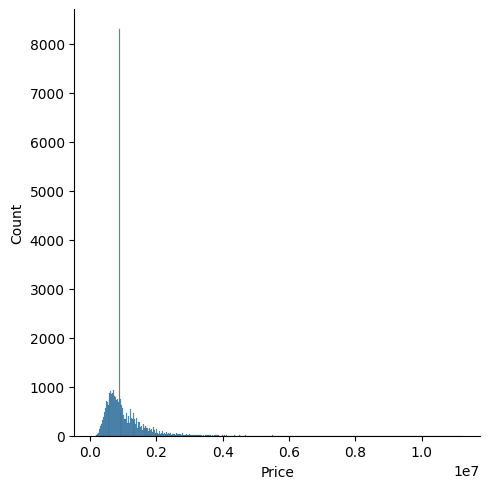

In [18]:
sns.displot(data=df, x='Price')
plt.show()


(array([-2000000.,        0.,  2000000.,  4000000.,  6000000.,  8000000.,
        10000000., 12000000.]),
 [Text(-2000000.0, 0, '−2000000'),
  Text(0.0, 0, '0'),
  Text(2000000.0, 0, '2000000'),
  Text(4000000.0, 0, '4000000'),
  Text(6000000.0, 0, '6000000'),
  Text(8000000.0, 0, '8000000'),
  Text(10000000.0, 0, '10000000'),
  Text(12000000.0, 0, '12000000')])

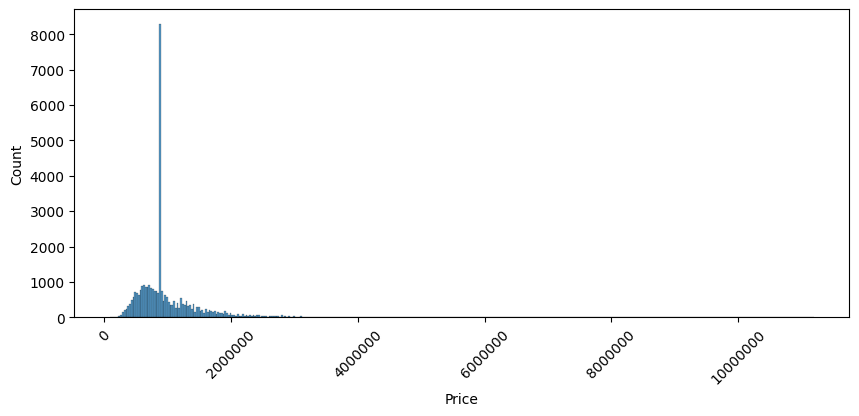

In [19]:
plt.figure(figsize=(10, 4))
df['Price'].fillna(df['Price'].median(), inplace=True)
sns.histplot(data=df, x='Price')
plt.ticklabel_format(style='plain', axis='x')
plt.xticks(rotation=45)


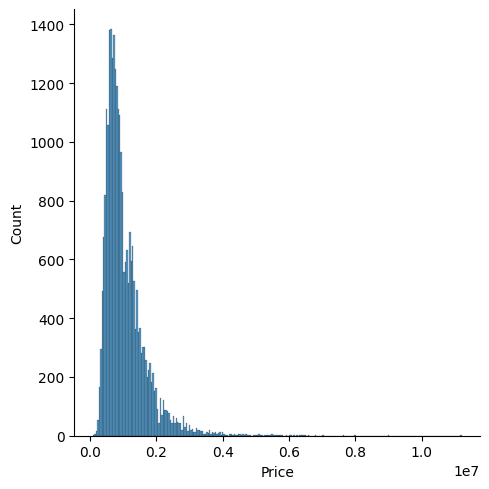

In [46]:

sns.displot(data=df, x='Price')
plt.show()

<AxesSubplot: xlabel='Bedroom2', ylabel='count'>

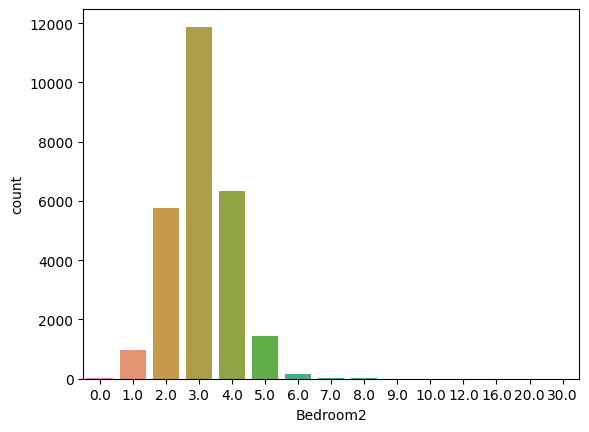

In [20]:
sns.countplot(data=df, x='Bedroom2')


In [21]:
# imputar valores nulos en Bathroom
filter = df['Bathroom'].isnull()
print(df[filter].index)

for i in df[filter].index:
    # filtro por Rooms
    filter = df['Rooms'] == df.iloc[i]['Rooms']
    
  # Imputar valor medio de baños según número de habitaciones
mean_bathrooms = df.groupby('Rooms')['Bathroom'].mean()
for i in df[filter].index:
    room_count = df.loc[i, 'Rooms']
    df.loc[i, 'Bathroom'] = mean_bathrooms[room_count]
    pass


Int64Index([   15,    16,    19,    21,    22,    26,    27,    33,    34,
               45,
            ...
            34801, 34813, 34816, 34829, 34832, 34838, 34839, 34840, 34844,
            34855],
           dtype='int64', length=8226)


In [47]:
from data_util import calc_missing
# el archivo data_util.py tiene que estar en el mismo directorio
calc_missing(df)

Price 7610 / 34857 21.83 %
Distance 1 / 34857 0.00 %
Postcode 1 / 34857 0.00 %
Bedroom2 8217 / 34857 23.57 %
Bathroom 8226 / 34857 23.60 %
Car 8728 / 34857 25.04 %
Landsize 11810 / 34857 33.88 %
BuildingArea 21115 / 34857 60.58 %
YearBuilt 19306 / 34857 55.39 %
CouncilArea 3 / 34857 0.01 %
Lattitude 7976 / 34857 22.88 %
Longtitude 7976 / 34857 22.88 %
Regionname 3 / 34857 0.01 %
Propertycount 3 / 34857 0.01 %


<AxesSubplot: xlabel='BuildingArea'>

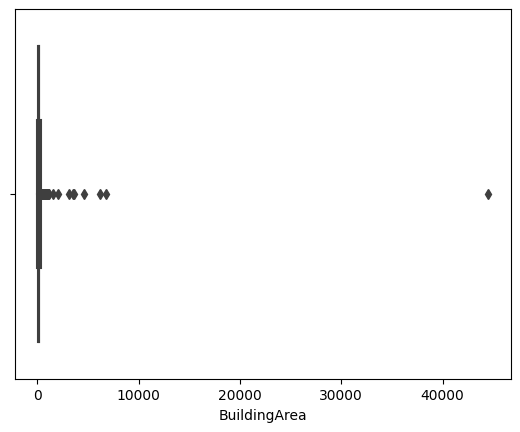

In [48]:
sns.boxplot(data=df, x='BuildingArea')

<AxesSubplot: xlabel='BuildingArea'>

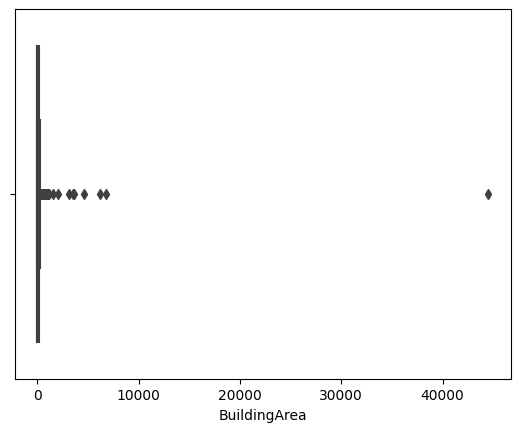

In [49]:
df['BuildingArea'].fillna(0, inplace=True)
sns.boxplot(data=df, x='BuildingArea')

In [50]:
calc_missing(df)

Price 7610 / 34857 21.83 %
Distance 1 / 34857 0.00 %
Postcode 1 / 34857 0.00 %
Bedroom2 8217 / 34857 23.57 %
Bathroom 8226 / 34857 23.60 %
Car 8728 / 34857 25.04 %
Landsize 11810 / 34857 33.88 %
YearBuilt 19306 / 34857 55.39 %
CouncilArea 3 / 34857 0.01 %
Lattitude 7976 / 34857 22.88 %
Longtitude 7976 / 34857 22.88 %
Regionname 3 / 34857 0.01 %
Propertycount 3 / 34857 0.01 %


<AxesSubplot: xlabel='Bedroom2'>

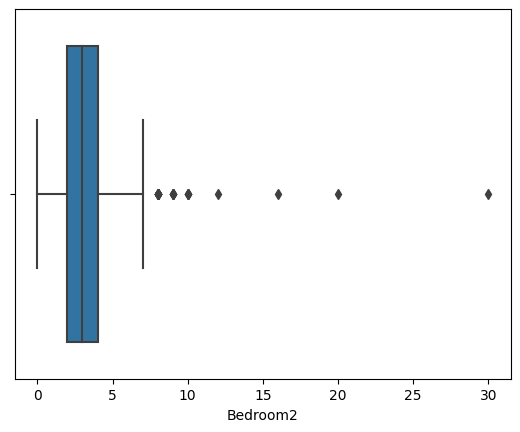

In [51]:
sns.boxplot(data=df, x='Bedroom2')

<!-- # Opción 1. Rellenar con la moda
# sns.countplot(data=df, x='Bedroom2')
# df['Bedroom2'].fillna(df['Bedroom2'].mode()[0], inplace=True)

# Opción 2. Rellenar Bedroom2 con la moda/mediana de Bedroom2 en las filas que tengan los mismos valores en columnas correlacionadas


# Opción 3. KNNImputer -->

In [52]:
df[['Rooms', 'Bedroom2']].tail(40)

,Rooms,Bedroom2
34817,3,3.0
34818,4,4.0
34819,3,3.0
34820,4,4.0
34821,3,3.0
34822,2,2.0
34823,5,5.0
34824,5,5.0
34825,4,4.0
34826,4,4.0


## Borrar columnas


In [22]:
# Borrar columnas Bedroom2
df.drop('Bedroom2', axis=1, inplace=True)


In [23]:
df.head()


,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,Abbotsford,68 Studley St,2,h,870000.0,SS,Jellis,3/09/2016,2.5,3067.0,1.000000,1.0,126.0,NaN,NaN,Yarra City Council,-37.8014,144.9958,Northern Metropolitan,4019.0
1,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,1.000000,1.0,202.0,NaN,NaN,Yarra City Council,-37.7996,144.9984,Northern Metropolitan,4019.0
2,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,1.000000,0.0,156.0,79.0,1900.0,Yarra City Council,-37.8079,144.9934,Northern Metropolitan,4019.0
3,Abbotsford,18/659 Victoria St,3,u,870000.0,VB,Rounds,4/02/2016,2.5,3067.0,1.493327,1.0,0.0,NaN,NaN,Yarra City Council,-37.8114,145.0116,Northern Metropolitan,4019.0
4,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,1.493327,0.0,134.0,150.0,1900.0,Yarra City Council,-37.8093,144.9944,Northern Metropolitan,4019.0


Análisis bivariante


<AxesSubplot: xlabel='Bathroom', ylabel='Rooms'>

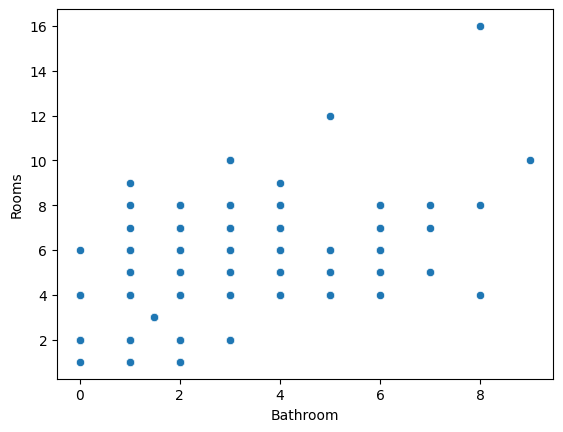

In [25]:
# Bathroom con: Rooms, Price, Car
sns.scatterplot(data=df, x='Bathroom', y='Rooms')


<AxesSubplot: xlabel='Bathroom', ylabel='Price'>

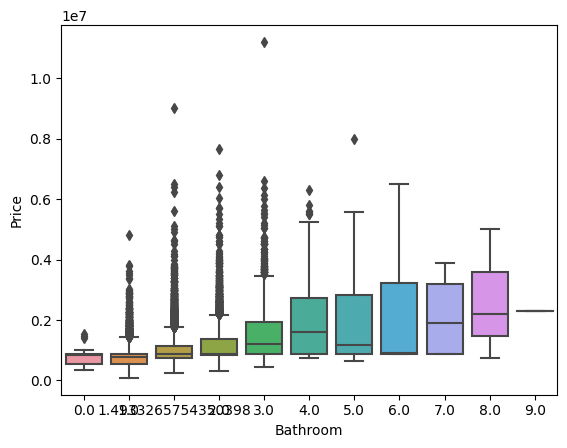

In [26]:
sns.boxplot(data=df, x='Bathroom', y='Price')


<AxesSubplot: xlabel='Bathroom', ylabel='Car'>

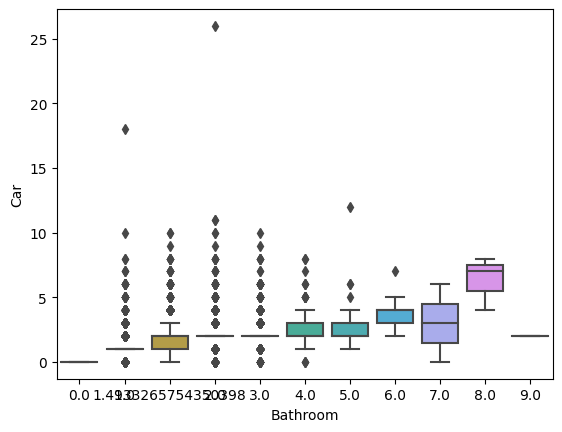

In [27]:
sns.boxplot(data=df, x='Bathroom', y='Car')


<AxesSubplot: xlabel='Bathroom', ylabel='Price'>

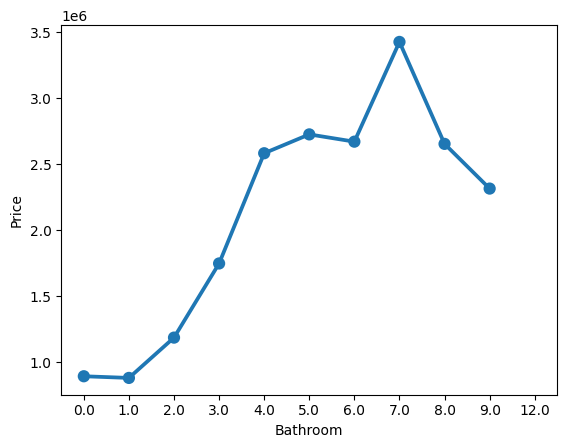

In [54]:
sns.pointplot(data=df, x='Bathroom', y='Price', errorbar=None)


<AxesSubplot: xlabel='Bathroom', ylabel='Price'>

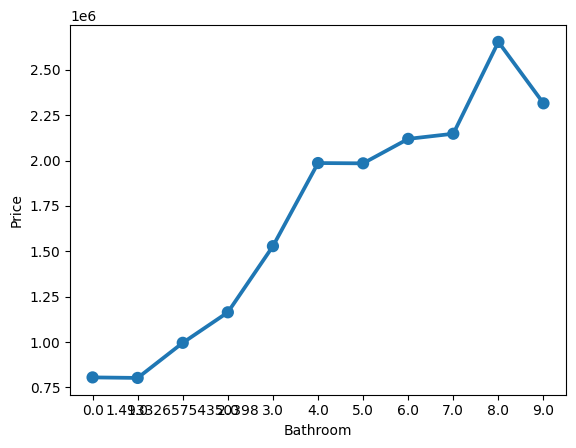

In [28]:
sns.pointplot(data=df, x='Bathroom', y='Price', errorbar=None)


<AxesSubplot: xlabel='Bathroom', ylabel='Price'>

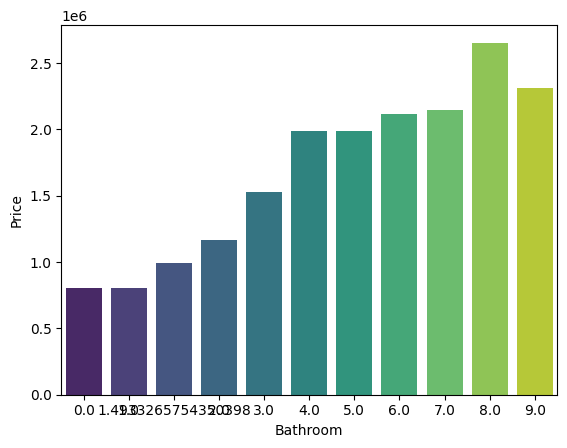

In [29]:
sns.barplot(data=df, x='Bathroom', y='Price', errorbar=None, palette='viridis')


<AxesSubplot: xlabel='Bathroom', ylabel='Price'>

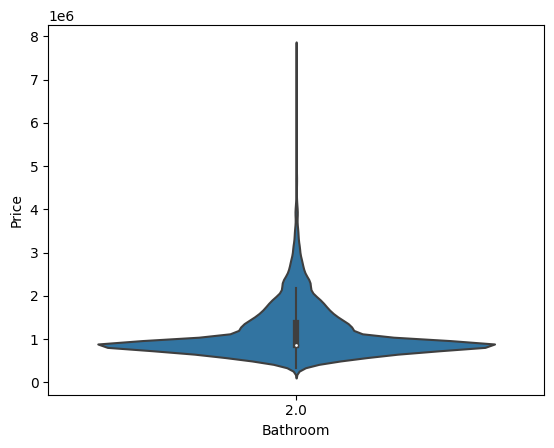

In [30]:
# plt.figure(figsize=(10, 8))
# filter = (df['Bathroom'] == 1) | (df['Bathroom'] == 3)
# filter = df['Bathroom'].between(0,3)
filter = df['Bathroom'] == 2
sns.violinplot(data=df[filter], x='Bathroom', y='Price')


<AxesSubplot: xlabel='Bathroom', ylabel='Price'>

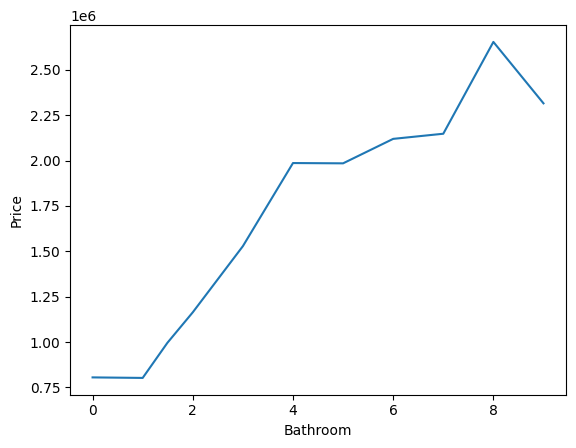

In [31]:
# calcular el precio medio por Bathroom
df_bath_price = df.groupby('Bathroom')['Price'].mean().reset_index()
sns.lineplot(data=df_bath_price, x='Bathroom', y='Price')


In [32]:
# filtrar lo que tengan más de 7 baños
filter = df['Bathroom'] > 7
df_8_bath = df[filter]
df_8_bath.shape  # Hay 5 casas de más de 7 baños


(4, 20)

In [33]:
# excluir las que tengan más de 7 baños
filter = df['Bathroom'] <= 7
df_8_bath = df[filter]
df_8_bath.shape


(29873, 20)

In [34]:
# borrar las que tengan más de 7 baños
filter = df['Bathroom'] > 7
print(df.shape)
df.drop(df[filter].index, inplace=True)  # Borra las filas
print(df.shape)


(34857, 20)
(34853, 20)


<AxesSubplot: xlabel='Bathroom', ylabel='Price'>

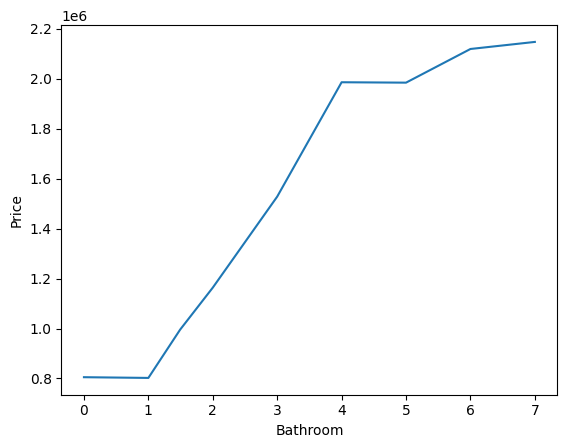

In [35]:
df_bath_price = df.groupby('Bathroom')['Price'].mean().reset_index()
sns.lineplot(data=df_bath_price, x='Bathroom', y='Price')


In [55]:
# filter = df['Rooms'] == df.iloc[15]['Rooms']
# df['Bathroom'][filter].median()

In [56]:
df['Bathroom'].value_counts()

1.0     12969
2.0     11064
3.0      2181
4.0       269
5.0        77
0.0        46
6.0        16
7.0         4
8.0         3
12.0        1
9.0         1
Name: Bathroom, dtype: int64

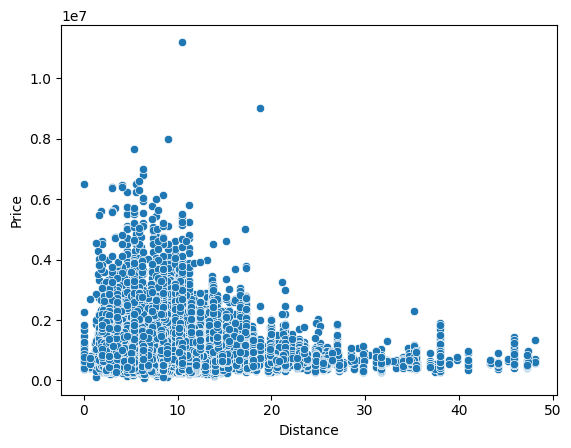

In [57]:
sns.scatterplot(data=df, x='Distance', y='Price');

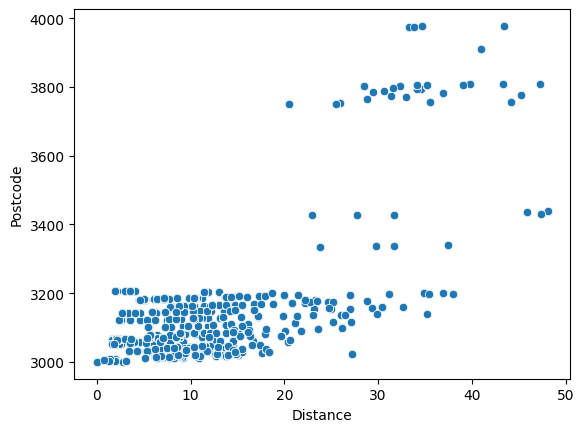

In [58]:
sns.scatterplot(data=df, x='Distance', y='Postcode');

In [59]:
df.head(1)

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,...,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,Abbotsford,68 Studley St,2,h,NaN,SS,Jellis,3/09/2016,2.5,3067.0,...,1.0,1.0,126.0,0.0,NaN,Yarra City Council,-37.8014,144.9958,Northern Metropolitan,4019.0


<AxesSubplot: xlabel='Method', ylabel='Price'>

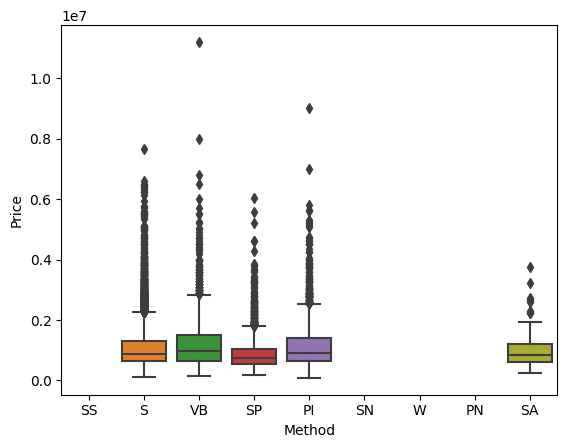

In [60]:
# sns.boxplot(data=df, x='Type', y='Price')
sns.boxplot(data=df, x='Method', y='Price')

# sns.countplot(data=df, x='Regionname')
# plt.xticks(rotation=45);

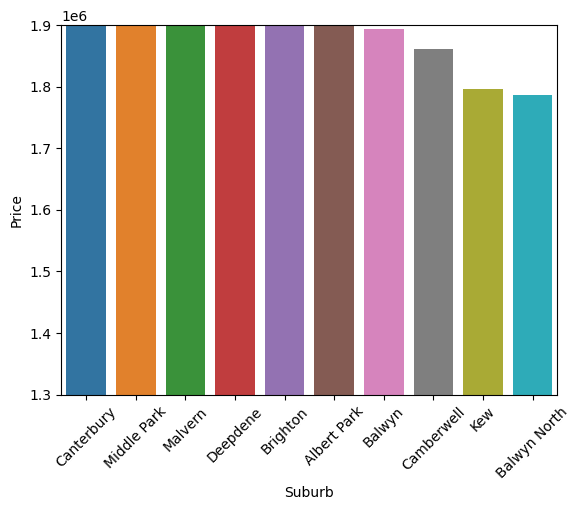

In [61]:
# Los 10 barrios más baratos en precio promedio
# df_suburb = df.groupby('Suburb')['Price'].mean().reset_index().sort_values('Price')[:10]
# df_suburb = df.groupby('Suburb')['Price'].mean().nsmallest(10).reset_index()

# Los 10 barrios más caros en precio promedio
# df_suburb = df.groupby('Suburb')['Price'].mean().reset_index().sort_values('Price', ascending=False)[:10]
df_suburb = df.groupby('Suburb')['Price'].mean().nlargest(10).reset_index()

ax = sns.barplot(data=df_suburb, x='Suburb', y='Price')
plt.xticks(rotation=45);
# ax.set_ylim([350000, 600000])
ax.set_ylim([1300000, 1900000]);

c:\Users\Jholman Cuartas\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\axisgrid.py:712: UserWarning: Using the boxplot function without specifying `order` is likely to produce an incorrect plot.
  warnings.warn(warning)


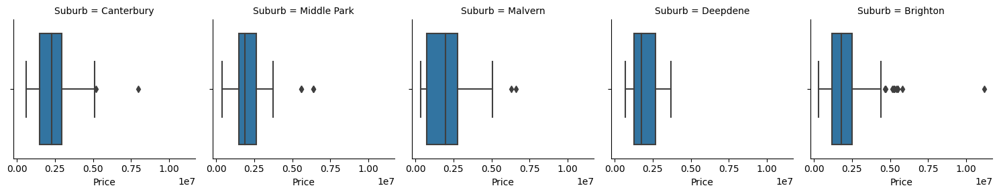

In [62]:
top_suburbs = df.groupby('Suburb')['Price'].mean().nlargest(5).index
filter = df['Suburb'].isin(top_suburbs)
grid = sns.FacetGrid(df[filter], col='Suburb', col_wrap=5, height=3, col_order=top_suburbs)
grid.map(sns.boxplot, 'Price');

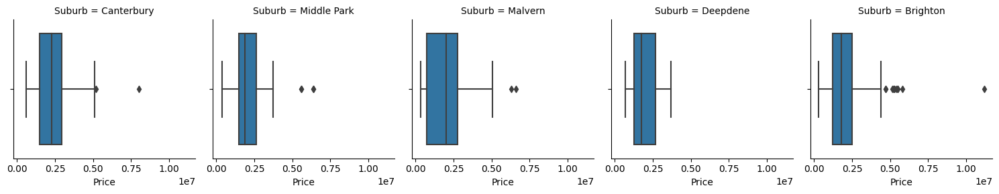

In [63]:
sns.catplot(data=df[filter], x='Price', col='Suburb', kind='box', height=3, col_order=top_suburbs);

## Fechas

In [65]:
len(df['Date'].unique())

78

In [66]:
df['Date'].value_counts()

28/10/2017    1119
17/03/2018     970
24/02/2018     941
9/12/2017      927
25/11/2017     902
              ... 
4/02/2016       44
30/09/2017      22
20/01/2018      19
27/01/2018      12
28/01/2016       3
Name: Date, Length: 78, dtype: int64

In [67]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34857 entries, 0 to 34856
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Suburb         34857 non-null  object 
 1   Address        34857 non-null  object 
 2   Rooms          34857 non-null  int64  
 3   Type           34857 non-null  object 
 4   Price          27247 non-null  float64
 5   Method         34857 non-null  object 
 6   SellerG        34857 non-null  object 
 7   Date           34857 non-null  object 
 8   Distance       34856 non-null  float64
 9   Postcode       34856 non-null  float64
 10  Bedroom2       26640 non-null  float64
 11  Bathroom       26631 non-null  float64
 12  Car            26129 non-null  float64
 13  Landsize       23047 non-null  float64
 14  BuildingArea   34857 non-null  float64
 15  YearBuilt      15551 non-null  float64
 16  CouncilArea    34854 non-null  object 
 17  Lattitude      26881 non-null  float64
 18  Longti

In [68]:
df['Date'] = pd.to_datetime(df['Date'], dayfirst=False) ## DD-MM-YYYY
df['year'] = df['Date'].dt.year
df['quarter'] = df['Date'].dt.quarter
df['month'] = df['Date'].dt.month
df['week_num'] = df['Date'].dt.isocalendar().week

C:\Users\Jholman Cuartas\AppData\Local\Temp\ipykernel_17576\536737816.py:1: UserWarning: Parsing dates in DD/MM/YYYY format when dayfirst=False (the default) was specified. This may lead to inconsistently parsed dates! Specify a format to ensure consistent parsing.
  df['Date'] = pd.to_datetime(df['Date'], dayfirst=False) ## DD-MM-YYYY


In [69]:
df.head(1)

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,...,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount,year,quarter,month,week_num
0,Abbotsford,68 Studley St,2,h,NaN,SS,Jellis,2016-03-09,2.5,3067.0,...,NaN,Yarra City Council,-37.8014,144.9958,Northern Metropolitan,4019.0,2016,1,3,10


<AxesSubplot: xlabel='year', ylabel='count'>

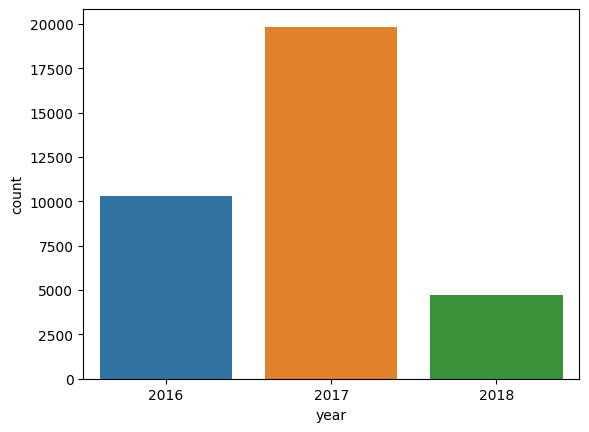

In [70]:
# número de viviendas vendidas por año
sns.countplot(data=df, x='year')

<AxesSubplot: xlabel='month', ylabel='count'>

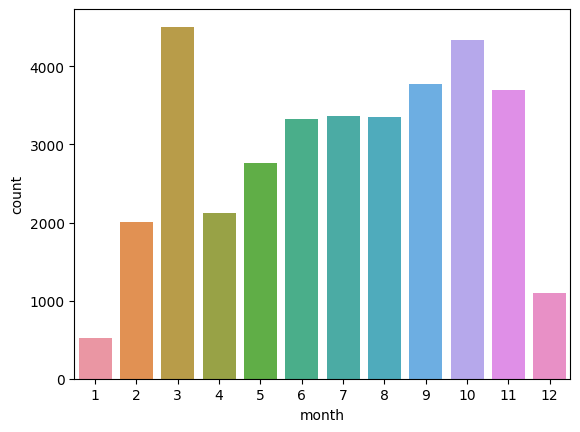

In [71]:
sns.countplot(data=df, x='month')

<AxesSubplot: xlabel='quarter', ylabel='count'>

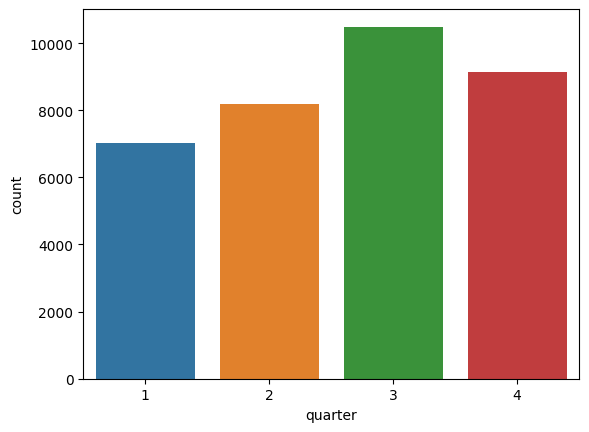

In [72]:
sns.countplot(data=df, x='quarter')

<AxesSubplot: xlabel='week_num', ylabel='count'>

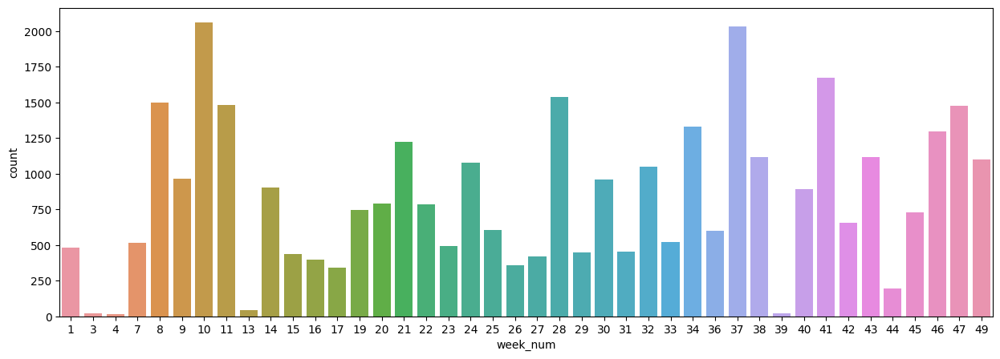

In [73]:
plt.figure(figsize=(15,5))
sns.countplot(data=df, x='week_num')

<AxesSubplot: xlabel='week_num', ylabel='count'>

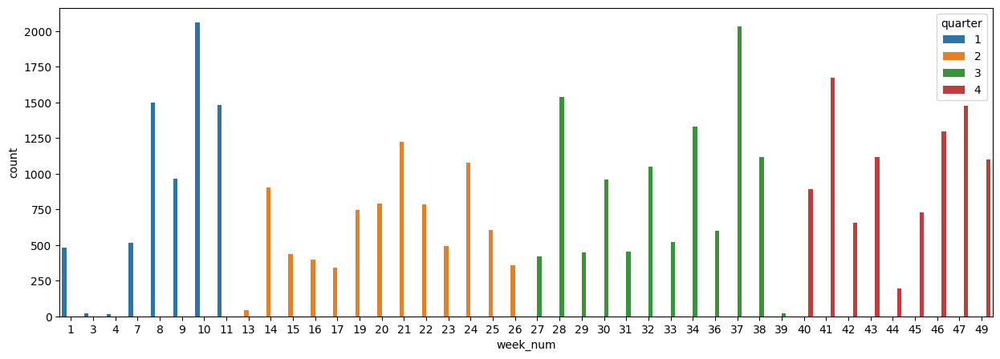

In [74]:
plt.figure(figsize=(15,5))
sns.countplot(data=df, x='week_num', hue='quarter')

<AxesSubplot: xlabel='month', ylabel='count'>

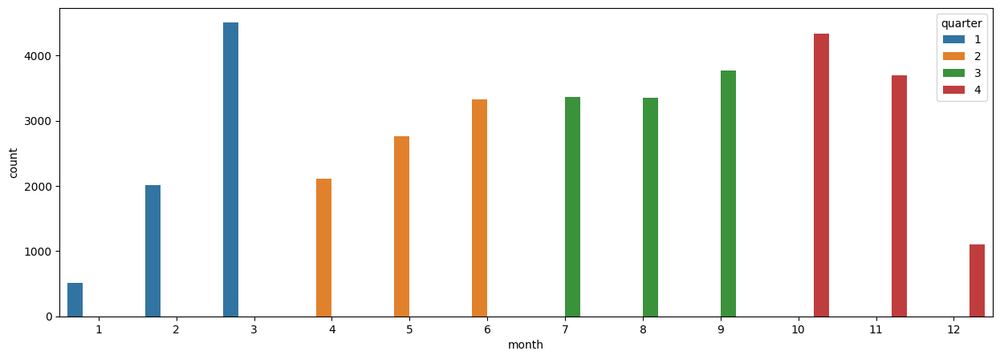

In [75]:
plt.figure(figsize=(15,5))
sns.countplot(data=df, x='month', hue='quarter')

<AxesSubplot: xlabel='count', ylabel='week_num'>

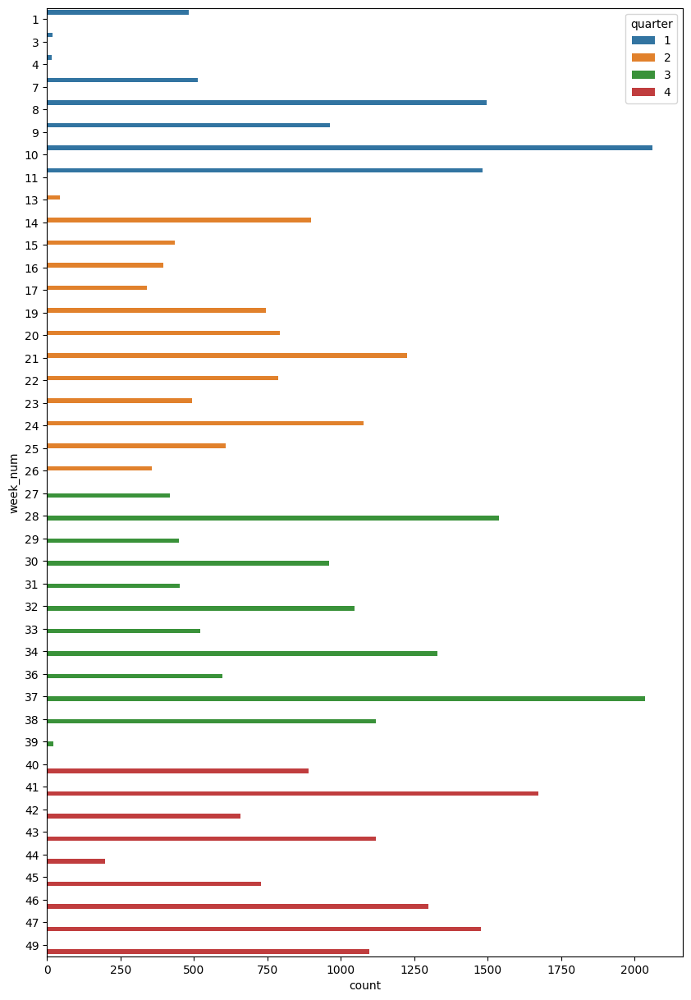

In [76]:
plt.figure(figsize=(10,15))
sns.countplot(data=df, y='week_num', hue='quarter')

(900000.0, 1100000.0)

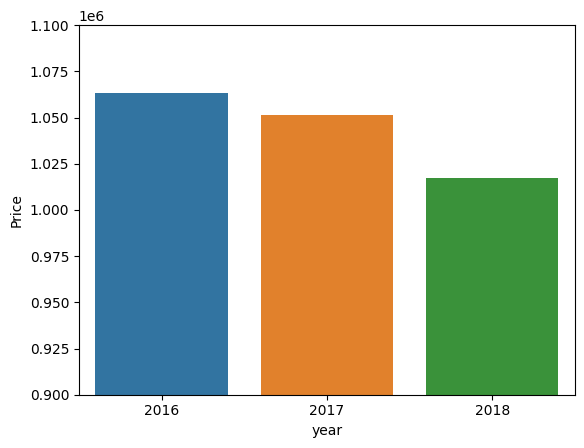

In [77]:
df_price_per_year = df.groupby('year')['Price'].mean().reset_index()
ax = sns.barplot(data=df_price_per_year, x='year', y='Price')
ax.set_ylim([900000, 1100000])

(800000.0, 1100000.0)

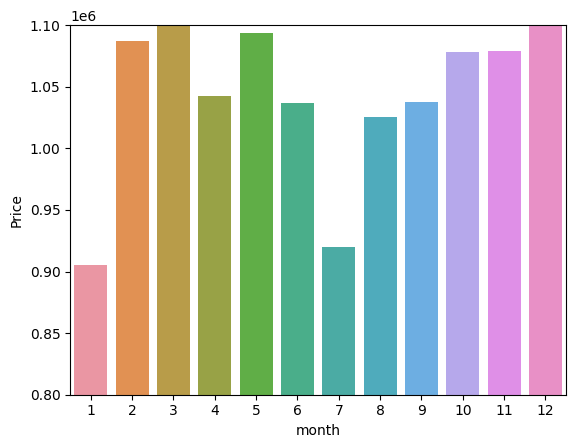

In [78]:
df_price_per_month = df.groupby('month')['Price'].mean().reset_index()
ax = sns.barplot(data=df_price_per_month, x='month', y='Price')
ax.set_ylim([800000, 1100000])

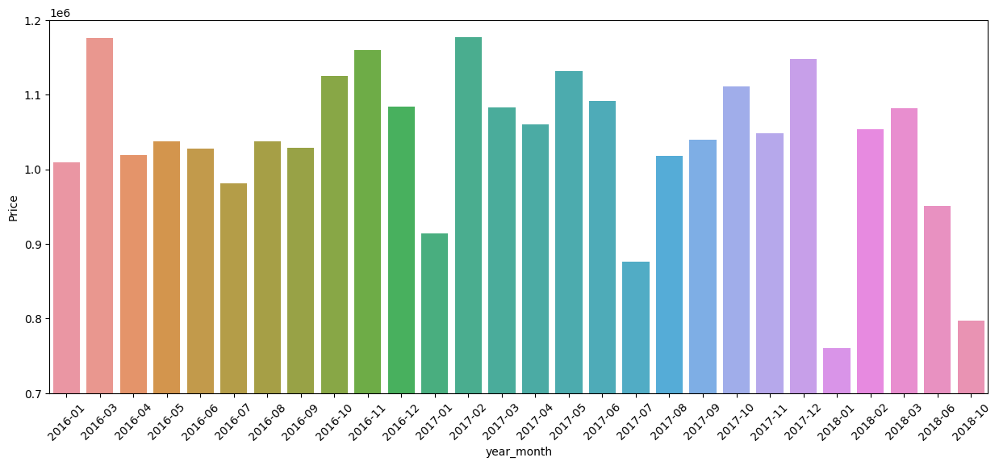

In [80]:
plt.figure(figsize=(15, 6))
df_price_per_month = df.groupby('year_month')['Price'].mean().reset_index()
ax = sns.barplot(data=df_price_per_month, x='year_month', y='Price')
ax.set_ylim([700000, 1200000])
plt.xticks(rotation=45);

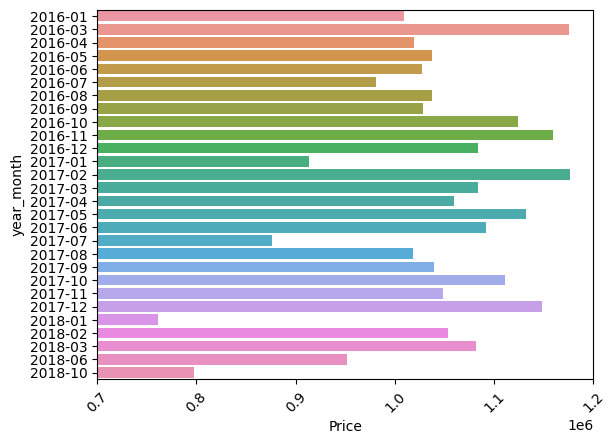

In [81]:
# plt.figure(figsize=(15, 15))
df_price_per_month = df.groupby('year_month')['Price'].mean().reset_index()
ax = sns.barplot(data=df_price_per_month, x='Price', y='year_month')
# ax.set_ylim([700000, 1200000])
ax.set_xlim([700000, 1200000])
plt.xticks(rotation=45);

In [82]:
# agrupar precio medio por year y month en la misma agrupación
# Saber trabajar con 2 columnas a la vez
df_year_month = df.groupby(['year', 'month'])['Price'].mean()
df_year_month

year  month
2016  1        1.009000e+06
      3        1.175837e+06
      4        1.019294e+06
      5        1.037713e+06
      6        1.027206e+06
      7        9.809688e+05
      8        1.037344e+06
      9        1.028593e+06
      10       1.124598e+06
      11       1.159202e+06
      12       1.083740e+06
2017  1        9.136368e+05
      2        1.176877e+06
      3        1.083288e+06
      4        1.059979e+06
      5        1.131942e+06
      6        1.091816e+06
      7        8.761150e+05
      8        1.017826e+06
      9        1.039554e+06
      10       1.110624e+06
      11       1.048016e+06
      12       1.148212e+06
2018  1        7.607869e+05
      2        1.053868e+06
      3        1.081352e+06
      6        9.512821e+05
      10       7.975032e+05
Name: Price, dtype: float64

In [83]:
df_year_month = df.groupby(['year', 'month'])['Price'].mean()
df_year_month

# unstack() extrae el índice a una columna creando una TABLA PIVOTANTE POR MONTH / YEAR
df_year_month = df_year_month.unstack(level=0)
df_year_month

df_year_month = df_year_month.reset_index().rename_axis(None,axis=1) 
df_year_month

# unpivot: despivotar los valores de las columnas a una fila: convierte de ancho a largo
# id_vars (1-12): se duplica para cada valor único de año 2016, 2017, 2018
# var_name (year): el nombre de la nueva columna al despivotar los años 2016, 2017, 2018
# value_name (price): el nombre de la nueva columna que tendrá los valores numéricos que estaban en 2016, 2017 y 2018
df_year_month = df_year_month.melt(var_name='year', id_vars='month', value_name='Price')
df_year_month

,month,year,Price
0,1,2016,1.009000e+06
1,2,2016,NaN
2,3,2016,1.175837e+06
3,4,2016,1.019294e+06
4,5,2016,1.037713e+06
5,6,2016,1.027206e+06
6,7,2016,9.809688e+05
7,8,2016,1.037344e+06
8,9,2016,1.028593e+06
9,10,2016,1.124598e+06


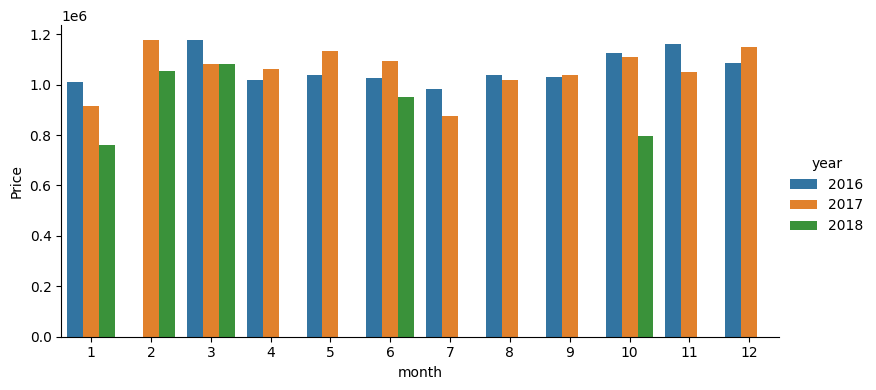

In [84]:
sns.catplot(data=df_year_month, x='month', y='Price', hue='year', kind='bar', height=4, aspect=2);

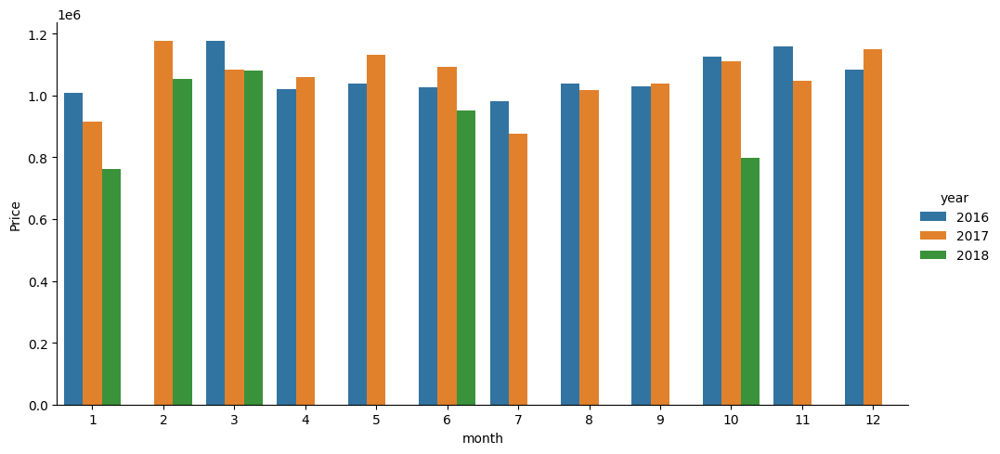

In [85]:
sns.catplot(
    data=df, x='month', y='Price', hue='year', kind='bar', errorbar=None, height=5, aspect=2
    );

## Rellenar valores faltantes

In [86]:
# imputar valores nulos en Bathroom basándonos en la columna Rooms por ser la más correlacionada con Bathroom
filter1 = df['Bathroom'].isnull()

for i in df[filter1].index:
    filter2 = df['Rooms'] == df.loc[i, 'Rooms']
    median = df.loc[filter2, 'Bathroom'].median()

    if not pd.isnull(median):
        df.loc[i, 'Bathroom'] = median
    else:
        df.loc[i, 'Bathroom'] = df['Bathroom'].median()


In [87]:
df['Bathroom'] = df['Bathroom'].round().astype(int)
df['Bathroom'].value_counts()

1     19432
2     12531
3      2475
4       269
5        79
0        46
6        16
7         4
8         3
12        1
9         1
Name: Bathroom, dtype: int64

In [88]:
calc_missing(df)

Price 7610 / 34857 21.83 %
Distance 1 / 34857 0.00 %
Postcode 1 / 34857 0.00 %
Bedroom2 8217 / 34857 23.57 %
Car 8728 / 34857 25.04 %
Landsize 11810 / 34857 33.88 %
YearBuilt 19306 / 34857 55.39 %
CouncilArea 3 / 34857 0.01 %
Lattitude 7976 / 34857 22.88 %
Longtitude 7976 / 34857 22.88 %
Regionname 3 / 34857 0.01 %
Propertycount 3 / 34857 0.01 %


## Mapas, Geolocalización: Latitud y Longitud

In [89]:
df.head()

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,...,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount,year,quarter,month,week_num,year_month
0,Abbotsford,68 Studley St,2,h,NaN,SS,Jellis,2016-03-09,2.5,3067.0,...,Yarra City Council,-37.8014,144.9958,Northern Metropolitan,4019.0,2016,1,3,10,2016-03
1,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,2016-03-12,2.5,3067.0,...,Yarra City Council,-37.7996,144.9984,Northern Metropolitan,4019.0,2016,1,3,10,2016-03
2,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,2016-04-02,2.5,3067.0,...,Yarra City Council,-37.8079,144.9934,Northern Metropolitan,4019.0,2016,2,4,13,2016-04
3,Abbotsford,18/659 Victoria St,3,u,NaN,VB,Rounds,2016-04-02,2.5,3067.0,...,Yarra City Council,-37.8114,145.0116,Northern Metropolitan,4019.0,2016,2,4,13,2016-04
4,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,2017-04-03,2.5,3067.0,...,Yarra City Council,-37.8093,144.9944,Northern Metropolitan,4019.0,2017,2,4,14,2017-04


In [90]:
# https://geopy.readthedocs.io/en/stable/
# pip install geopy

# Obtener coordenadas a partir de una dirección
from geopy.geocoders import Nominatim

address = '68 Studley St Abbotsford'

geolocator = Nominatim(user_agent="MozillaFirefox")
location = geolocator.geocode(address)

print(location.latitude, location.longitude)

-37.8014257 144.9951832


In [91]:
# Obtener dirección a partir de unas coordenadas
latitude = -37.8014257
longitude = 144.9951832

geolocator = Nominatim(user_agent="MozillaFirefox")
location = geolocator.reverse([latitude, longitude])

print(location.address)

for text in location.address.split(','):
    print(text)


Park Terrace, Park Street, Abbotsford, Melbourne, City of Yarra, Victoria, 3067, Australia
Park Terrace
 Park Street
 Abbotsford
 Melbourne
 City of Yarra
 Victoria
 3067
 Australia


In [79]:
# https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.to_period.html

df['year_month'] = df['Date'].dt.to_period('M')
df.head(1)

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,...,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount,year,quarter,month,week_num,year_month
0,Abbotsford,68 Studley St,2,h,NaN,SS,Jellis,2016-03-09,2.5,3067.0,...,Yarra City Council,-37.8014,144.9958,Northern Metropolitan,4019.0,2016,1,3,10,2016-03


In [36]:
df = pd.read_csv(
    'C:\\Users\\Jholman Cuartas\\Desktop\\curso_analisis_datos\\data\\Melbourne_housing_FULL.csv')
df


,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,...,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,Abbotsford,68 Studley St,2,h,NaN,SS,Jellis,3/09/2016,2.5,3067.0,...,1.0,1.0,126.0,NaN,NaN,Yarra City Council,-37.80140,144.99580,Northern Metropolitan,4019.0
1,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,...,1.0,1.0,202.0,NaN,NaN,Yarra City Council,-37.79960,144.99840,Northern Metropolitan,4019.0
2,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,...,1.0,0.0,156.0,79.0,1900.0,Yarra City Council,-37.80790,144.99340,Northern Metropolitan,4019.0
3,Abbotsford,18/659 Victoria St,3,u,NaN,VB,Rounds,4/02/2016,2.5,3067.0,...,2.0,1.0,0.0,NaN,NaN,Yarra City Council,-37.81140,145.01160,Northern Metropolitan,4019.0
4,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,...,2.0,0.0,134.0,150.0,1900.0,Yarra City Council,-37.80930,144.99440,Northern Metropolitan,4019.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34852,Yarraville,13 Burns St,4,h,1480000.0,PI,Jas,24/02/2018,6.3,3013.0,...,1.0,3.0,593.0,NaN,NaN,Maribyrnong City Council,-37.81053,144.88467,Western Metropolitan,6543.0
34853,Yarraville,29A Murray St,2,h,888000.0,SP,Sweeney,24/02/2018,6.3,3013.0,...,2.0,1.0,98.0,104.0,2018.0,Maribyrnong City Council,-37.81551,144.88826,Western Metropolitan,6543.0
34854,Yarraville,147A Severn St,2,t,705000.0,S,Jas,24/02/2018,6.3,3013.0,...,1.0,2.0,220.0,120.0,2000.0,Maribyrnong City Council,-37.82286,144.87856,Western Metropolitan,6543.0
34855,Yarraville,12/37 Stephen St,3,h,1140000.0,SP,hockingstuart,24/02/2018,6.3,3013.0,...,NaN,NaN,NaN,NaN,NaN,Maribyrnong City Council,NaN,NaN,Western Metropolitan,6543.0


In [37]:
from geopy.geocoders import Nominatim
address = '68 Studley St Abbotsford'

geolocator = Nominatim(user_agent="GoogleChrome")
location = geolocator.geocode(address)

print(location.latitude, location.longitude)


-37.8014257 144.9951832


<AxesSubplot: xlabel='Longtitude', ylabel='Lattitude'>

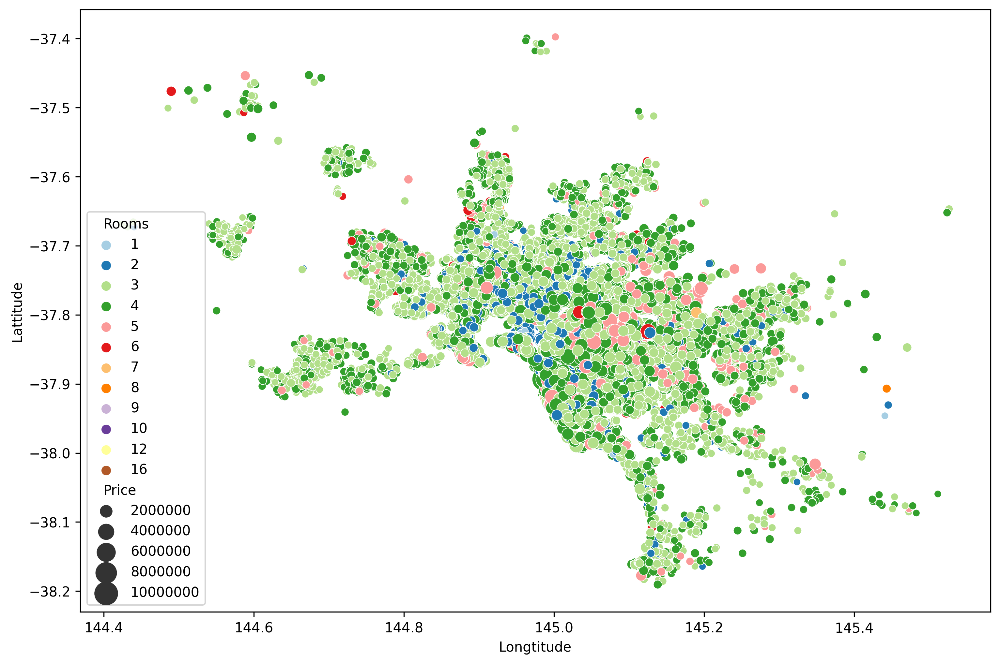

In [38]:
# sns.scatterplot
# sns.scatterplot
plt.figure(figsize=(12, 8), dpi=300)
sns.scatterplot(data=df,
                x='Longtitude', y='Lattitude', palette='Paired', hue='Rooms', size='Price', sizes=(20, 300))


In [39]:
import folium
map_center = [df['Lattitude'].median(), df['Longtitude'].median()]
m = folium.Map(location=map_center, zoom_start=12)

for index, row in df.iterrows():
    if pd.isnull(row['Lattitude']) or pd.isnull(row['Longtitude']):
        continue
    folium.CircleMarker(
        location=(row['Lattitude'], row['Longtitude']),
        radius=5,
        weight=1,
        fill_opacity=0.4
    ).add_to(m)

m


In [40]:
# mostrar las coordenadas
map_center = [df['Lattitude'].median(), df['Longtitude'].median()]
m = folium.Map(location=map_center, zoom_start=10)
coords = df[['Lattitude', 'Longtitude']].dropna().values.tolist()
coords


[[-37.8014, 144.9958],
 [-37.7996, 144.9984],
 [-37.8079, 144.9934],
 [-37.8114, 145.0116],
 [-37.8093, 144.9944],
 [-37.7969, 144.9969],
 [-37.8072, 144.9941],
 [-37.7965, 144.9965],
 [-37.7995, 144.9974],
 [-37.7996, 144.9989],
 [-37.8041, 144.9953],
 [-37.8024, 144.9993],
 [-37.8078, 144.9965],
 [-37.8066, 144.9936],
 [-37.806, 144.9954],
 [-37.8008, 144.9973],
 [-37.801, 144.9989],
 [-37.7998, 144.9972],
 [-37.811, 145.0067],
 [-37.8085, 144.9964],
 [-37.8078, 144.9965],
 [-37.8084, 144.9942],
 [-37.8084, 144.9973],
 [-37.8016, 144.9988],
 [-37.809, 144.9976],
 [-37.8093, 144.9959],
 [-37.8056, 144.993],
 [-37.8021, 144.9965],
 [-37.8022, 144.9975],
 [-37.8011, 145.0004],
 [-37.8073, 144.9952],
 [-37.8082, 144.9999],
 [-37.8093, 144.9959],
 [-37.8078, 144.9965],
 [-37.8015, 144.9972],
 [-37.8079, 144.9977],
 [-37.808, 144.994],
 [-37.8092, 144.9941],
 [-37.8016, 144.9988],
 [-37.8017, 145.0001],
 [-37.8078, 144.9965],
 [-37.8005, 144.9952],
 [-37.7994, 144.9965],
 [-37.7972, 144.99

In [41]:
# mostrar mapa de color
from folium.plugins import HeatMap
map_center = [df['Lattitude'].median(), df['Longtitude'].median()]
m = folium.Map(location=map_center, zoom_start=12)
folium.plugins.HeatMap(coords, min_opacity=0.4, blur=18).add_to(m)
m


In [42]:
# Obtener dirección a partir de unas coordenadas
latitude = -37.8014257
longitude = 144.9951832
geolocator = Nominatim(user_agent="GoogleChrome")
location = geolocator.geocode(address)

print(location.latitude, location.longitude)
print(location.address)


-37.8014257 144.9951832
Studley Street, Abbotsford, Melbourne, City of Yarra, Victoria, 3067, Australia


In [43]:
# Obtener dirección a partir de unas coordenadas
latitude = -37.8014257

geolocator = Nominatim(user_agent="GoogleChrome")
location = geolocator.geocode(address)

print(location.address)


Studley Street, Abbotsford, Melbourne, City of Yarra, Victoria, 3067, Australia


In [44]:
top_suburbs = df.grouphy('suborn')['Price'].mean()
filter = df['Suburb'].isin(top_suburbs)
grid = sns.FacetGrid(df[filter], col='Suburb', col_wrap=5, height=3, col_order=top: top_suburbs)
grid.map(sns.boxplot, 'Price')


SyntaxError: invalid syntax (2951170274.py, line 3)

## Análisis multivariante


In [ ]:
import folium


C:\Users\Jholman Cuartas\AppData\Local\Temp\ipykernel_12852\1471491446.py:3: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  df_corr = df.corr()


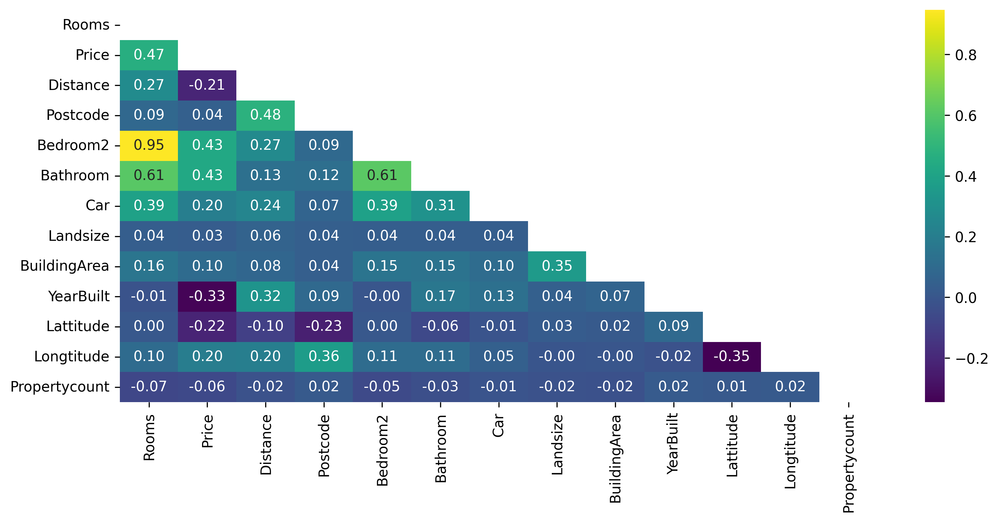

In [ ]:
import numpy as np
plt.figure(figsize=(12, 5), dpi=300)
df_corr = df.corr()
filter = np.triu(df_corr)
sns.heatmap(df_corr, annot=True, cmap='viridis', mask=filter, fmt=".2f")


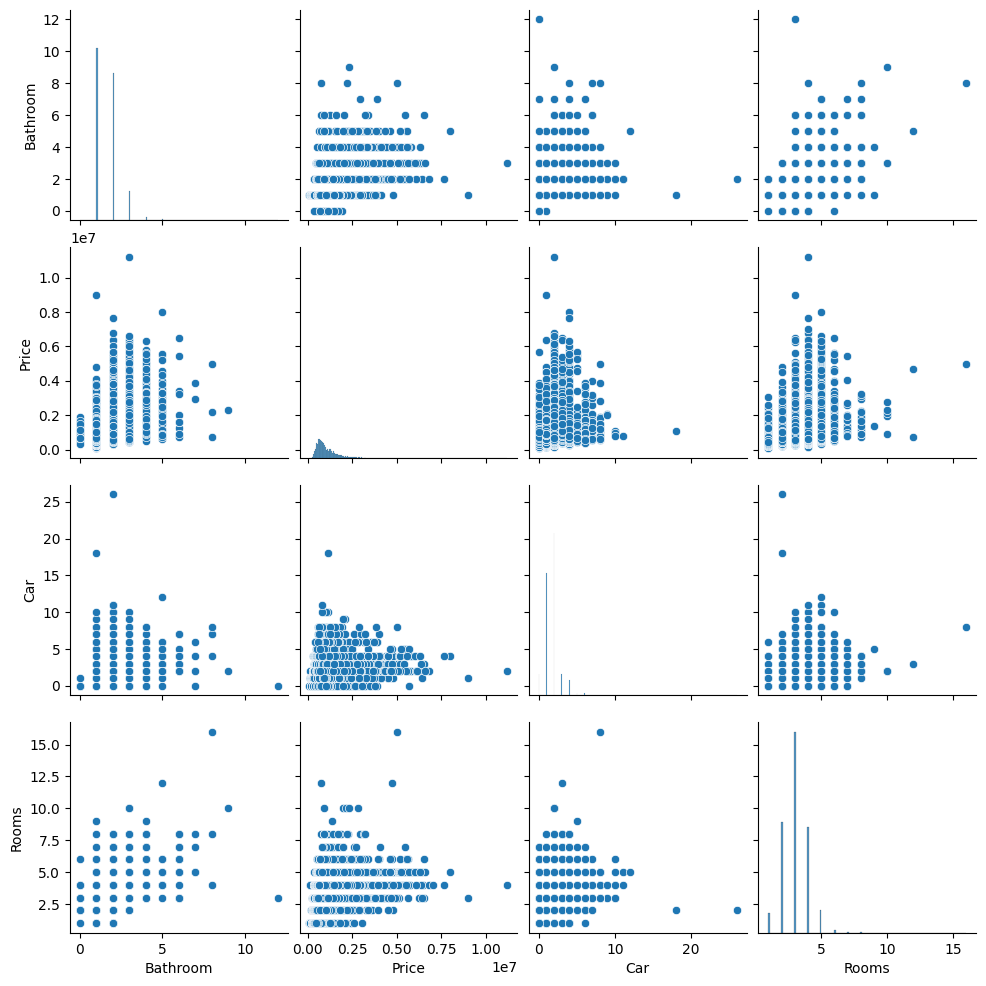

In [ ]:
# pairplot de Bathroom, Price, Rooms, Car
sns.pairplot(df[['Bathroom', 'Price', 'Car', 'Rooms']])


In [92]:
df['year']


0        2016
1        2016
2        2016
3        2016
4        2017
         ... 
34852    2018
34853    2018
34854    2018
34855    2018
34856    2018
Name: year, Length: 34857, dtype: int64